<font color='blue'> **03_Tacho_watershed** </font> 

In [25]:
import flopy ; import matplotlib.pyplot as plt ; import numpy as np ; from flopy.discretization import StructuredGrid ; import os
from typing import List, Tuple, Union ; from pathlib import Path ; import pandas as pd ; from flopy.utils.gridintersect import GridIntersect ; 
from shapely.geometry import LineString, Polygon ; import warnings ; warnings.filterwarnings("ignore", category=DeprecationWarning); from pandas import *
import earthpy.spatial as es ; import geopandas as gpd ; import rioxarray as rxr ; import rasterio as rio ;  from rasterio.plot import plotting_extent ; 
sim_ws = Path("./02_tacho_watershed") ;sim_ws.mkdir(exist_ok=True) #import pathlib as pl ; import pickle  ; import time ; 
import earthpy.plot as ep

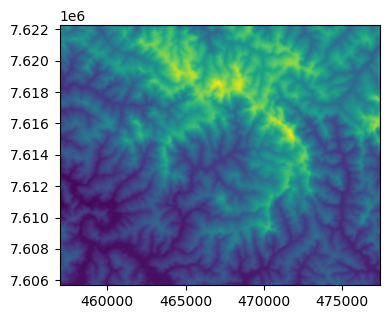

810.0 1243.0


In [20]:
ref_data = Path('E:\\15_REPOS\\b01_EarthPy\\Tacho_02')
fine_topo = flopy.utils.Raster.load(ref_data / "a00_Tacho_raster.tif")         #ascii_file = pl("E:/15_REPOS/00_BETAMI/bin/Flopy_data/fine_topo.asc") 
fig = plt.figure(figsize=(4,4))   ; ax = fig.add_subplot()  ; fine_topo.plot(ax=ax)    ; plt.show(block=False)  ; 
arr = fine_topo.get_array(1)      ; idx = np.isfinite(arr)  ; vmin, vmax = arr[idx].min(), arr[idx].max()       ; print(vmin, vmax)  ;cur_crs=fine_topo.crs

(1327, 1634)


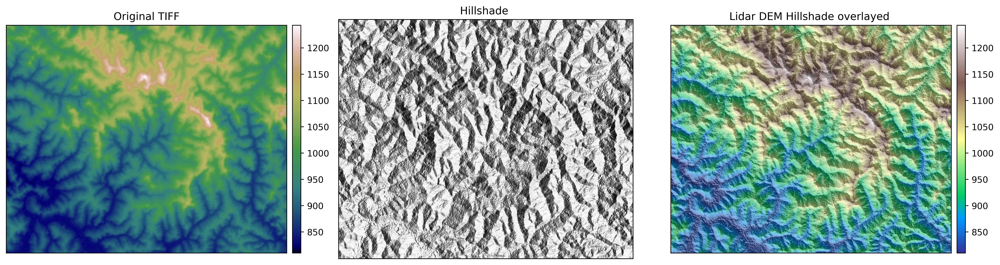

In [24]:
ref_data1a  =  ('E:\\15_REPOS\\b01_EarthPy\\Tacho_02\\a00_Tacho_raster.tif')
with rio.open(ref_data1a) as src:
    elevation = src.read(1).astype("float") ;     elevation[elevation < 0] = np.nan
hillshade = es.hillshade(elevation)
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16, 12), dpi=500)                  ; print(elevation.shape)
ep.plot_bands(elevation, cmap="gist_earth", title="Original TIFF"                    ,ax=ax[0]) 
az = es.hillshade(elevation, azimuth=90, altitude=50)  ; ep.plot_bands(az,cbar=False ,ax=ax[1], title="Hillshade ")   # 210 0
ep.plot_bands(elevation,cmap="terrain", title="Lidar DEM Hillshade overlayed "       ,ax=ax[2]) ; ax[2].imshow(hillshade, cmap="Greys",alpha=0.5) ;plt.show()

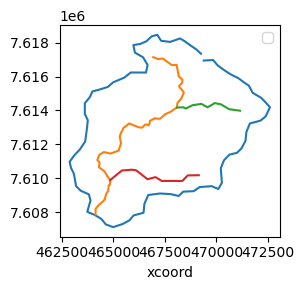

In [3]:
ref_data2 = os.path.join(ref_data ,'poly.xlsx')                                  ; xls = ExcelFile(ref_data2) ; df0 = xls.parse(xls.sheet_names[0]) ; df0.head(2)  
ref_data2 = os.path.join(ref_data ,'str1.xlsx')                                  ; xls = ExcelFile(ref_data2) ; df1 = xls.parse(xls.sheet_names[0]) ; df1.head(2)  
ref_data2 = os.path.join(ref_data ,'str2.xlsx')                                  ; xls = ExcelFile(ref_data2) ; df2 = xls.parse(xls.sheet_names[0]) ; df2.head(2)  
ref_data2 = os.path.join(ref_data ,'str3.xlsx')                                  ; xls = ExcelFile(ref_data2) ; df3 = xls.parse(xls.sheet_names[0]) ; df2.head(2)  

df0['ab'] = df0['xcoord'].astype(str) + ' ' + df0['ycoord'].astype(str)          ; 
df1['ab'] = df1['xcoord'].astype(str) + ' ' + df1['ycoord'].astype(str)          ; 
df2['ab'] = df2['xcoord'].astype(str) + ' ' + df2['ycoord'].astype(str)          ; 
df3['ab'] = df3['xcoord'].astype(str) + ' ' + df3['ycoord'].astype(str)          ; 

plt.rcParams["figure.figsize"]=[3,3]   ; plt.rcParams["figure.autolayout"] = True  ; 
ax = df0.plot(x='xcoord', y='ycoord')   
df1.plot(ax=ax, x='xcoord', y='ycoord') 
df2.plot(ax=ax, x='xcoord', y='ycoord') 
df3.plot(ax=ax, x='xcoord', y='ycoord') ; ax.legend([])

<font color='red'> **GIS** </font> 

In [4]:
SHP  = gpd.read_file(os.path.join(ref_data / '06_bacia_vetor.shp'  ))                 ; uTm_p0 = SHP.to_crs(es.crs_check(ref_data / "a00_Tacho_raster.tif" )) 
#SHP = gpd.read_file(os.path.join  (ref_data / 'srt_3p.shp'  ))                            ; uTm_s0 = SHP.to_crs(es.crs_check(ref_data / "a00_Tacho_raster.tif" )) 
SHP = gpd.read_file(os.path.join  (ref_data / 'str_1.shp'  ))                         ; uTm_s1 = SHP.to_crs(es.crs_check(ref_data / "a00_Tacho_raster.tif" )) 
#SHP = gpd.read_file(os.path.join  (ref_data / 'str_2.shp'  ))                         ; uTm_s2 = SHP.to_crs(es.crs_check(ref_data / "a00_Tacho_raster.tif" )) 
#SHP = gpd.read_file(os.path.join  (ref_data / 'str_3.shp'  ))                         ; uTm_s3 = SHP.to_crs(es.crs_check(ref_data / "a00_Tacho_raster.tif" )) 

TIF  = rxr.open_rasterio         (ref_data / "a00_Tacho_raster.tif", masked=True)     ; A_ex = plotting_extent(TIF[0], TIF.rio.transform())   ; print(cur_crs)
TIF2 = rxr.open_rasterio(ref_data/"a00_Tacho_raster.tif",masked=True).rio.clip(uTm_p0.geometry)       ; B_ext = plotting_extent(TIF2[0], TIF2.rio.transform())

EPSG:32723


<font color='blue'> **MODFLOW** </font> 

DIS(gwf.modelgrid):  xll:461809.7813; yll:7606705.25; rotation:0.0; crs:EPSG:32723; units:meters; lenuni:2


<Axes: >

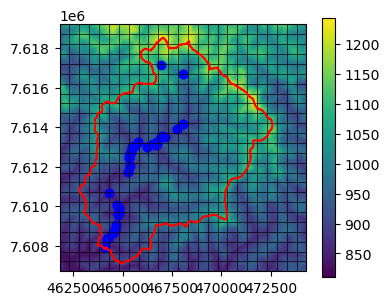

In [5]:
Lx=Ly= 12000 ; dx=dy=500.0                   ; nrow=int(Ly/dy)+1  ;ncol=int(Lx/dx)+1                             ; un  = "meters"
nlay = 1  ; dv0 = 5.0   ; leakance = 1.0 / (0.5 * dv0)   ; idomain = np.ones((nlay , nrow , ncol ), dtype=int)   ; epsg=32723  
top=np.ones((nlay,nrow,ncol),dtype=float);botm=np.zeros((nlay,nrow,ncol),dtype=float)                            ; xoff=B_ext[0]-1000 ;yoff=B_ext[2]-400
  
sim = flopy.mf6.MFSimulation (sim_ws=sim_ws ,exe_name="mf6" ,memory_print_option="summary" ,)
gwf = flopy.mf6.ModflowGwf   (sim , print_input=True ,save_flows=True ,newtonoptions="NEWTON UNDER_RELAXATION")
flopy.mf6.ModflowGwfdis (gwf ,length_units=un, nlay=nlay ,nrow=nrow ,ncol=ncol ,delr=dx ,delc=dy ,idomain=idomain ,
                         top=top ,botm=botm,xorigin=xoff ,yorigin=yoff)      ; gwf.modelgrid.epsg = epsg   ; print('DIS(gwf.modelgrid): ', gwf.modelgrid )

fig = plt.figure(figsize=(4, 4))  ; ax = fig.add_subplot(111) ; ax = fine_topo.plot(ax=ax, vmin=vmin, vmax=vmax)    ;plt.colorbar(ax.images[0], shrink=0.7)  
pmv = flopy.plot.PlotMapView (modelgrid=gwf.modelgrid)        ; pmv.plot_grid(ax=ax, lw=0.5, color="black") 
uTm_p0.boundary.plot(ax=ax, color='red')                   #   ; uTm_s0.boundary.plot(ax=ax, color='black') 
uTm_s1.boundary.plot(ax=ax, color='blue') 
#uTm_s2.boundary.plot(ax=ax, color='white') 
#uTm_s3.boundary.plot(ax=ax, color='black') ; 
# plt.show()

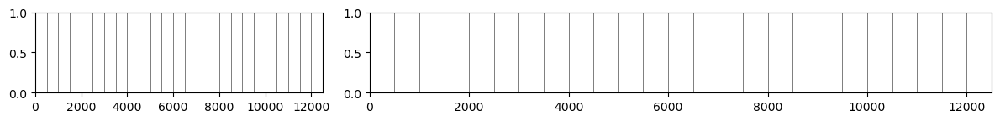

In [6]:
irow, icol = gwf.modelgrid.intersect(xoff+3200, yoff+2900)  
def beta_plot(ax):
    pmv=flopy.plot.PlotCrossSection(model=gwf,ax=ax2, line={"column": icol}) ; pmv.plot_grid(linewidth=0.5) ; pmv.plot_inactive()
    pmv=flopy.plot.PlotCrossSection(model=gwf,ax=ax1, line={"row"   : irow}) ; pmv.plot_grid(linewidth=0.5) ; pmv.plot_inactive()
plt.figure(figsize=(12,4))
ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=1, rowspan=1)  ; ax2 = plt.subplot2grid((3, 3), (0, 1), colspan=2, rowspan=1)  ; beta_plot(ax1) ; beta_plot(ax2) 

In [7]:
boundary_polygon = uTm_p0['geometry'].iloc[0]             
stream_segs = uTm_s1['geometry'].iloc[0]                  ; uTm_s1.head(5)    ; uTm_s1.to_csv (sim_ws / "01_merged_str.csv") 
#uTm_p0.to_csv (sim_ws / "02_poly.csv") 

In [8]:
def set_structured_idomain( modelgrid: flopy.discretization.StructuredGrid,   boundary: List[tuple] ) -> None:

    ix = GridIntersect(modelgrid, method="vertex", rtree=True)     ; result = ix.intersect(Polygon(boundary))
    idx = [coords for coords in result.cellids]                    ; idx = np.array(idx, dtype=int)               ; nr = idx.shape[0]
    if idx.ndim == 1:
        idx = idx.reshape((nr, 1))
    idx = tuple([idx[:, i] for i in range(idx.shape[1])])          ; idomain = np.zeros(modelgrid.shape[1:], dtype=int)
    idomain[idx] = 1 ; idomain = idomain.reshape(modelgrid.shape)  ;     modelgrid.idomain = idomain
    return
working_grid     = StructuredGrid(nlay=nlay,delr=np.full(ncol, dx) , delc=np.full(nrow, dy),
                                  xoff=xoff,yoff=yoff,top=np.full((nrow, ncol), 1000.0),botm=np.full((1, nrow, ncol), -100.0), crs = epsg)
set_structured_idomain(working_grid, boundary_polygon)

In [9]:
sgs = stream_segs
top_wg  = fine_topo.resample_to_grid(working_grid,band=fine_topo.bands[0],method="linear",extrapolate_edges=True)
def intersect_segments(modelgrid: Union[flopy.discretization.StructuredGrid, flopy.discretization.VertexGrid],
                       segments: List[List[tuple]]) -> Tuple[flopy.utils.GridIntersect, list, list]:
    ixs = flopy.utils.GridIntersect(modelgrid,method=modelgrid.grid_type)  ; cellids = []  ; lengths = []
    vv = ixs.intersect(LineString(segments)) ; cellids += vv["cellids"].tolist()  ; lengths += vv["lengths"].tolist()
    return ixs, cellids, lengths

ixs, cellids, lengths = intersect_segments(working_grid, sgs)  

In [10]:
def build_drain_data(modelgrid: Union[flopy.discretization.StructuredGrid, flopy.discretization.VertexGrid],cellids: list,
                     lengths: list,leakance: float,elevation: np.ndarray,) -> List[tuple]:
    drn_data = []
    for cellid, length in zip(cellids, lengths):
        x = modelgrid.xcellcenters[cellid]    ; width = 5.0 + (14.0 / Lx) * (Lx - x)  ; conductance = leakance * length * width
        if not isinstance(cellid, tuple):
            cellid = (cellid,)
        drn_data.append((0, *cellid, elevation[cellid], conductance))
    return drn_data
nlay = 5 ; dv0 = 5.0
leakance = 1.0 / (0.5 * dv0)  ; drn_data = build_drain_data(working_grid,cellids,lengths,leakance,top_wg)  #; drn_data[:10]

In [11]:
def cell_areas(modelgrid: Union[flopy.discretization.StructuredGrid, flopy.discretization.VertexGrid]) -> np.ndarray:
    if modelgrid.grid_type == "structured":
        nrow, ncol = modelgrid.nrow, modelgrid.ncol ; areas = np.zeros((nrow, ncol), dtype=float)
        for r in range(nrow):
            for c in range(ncol): 
                cellid = (r, c) ; vertices = np.array(modelgrid.get_cell_vertices(cellid)) ; area = Polygon(vertices).area ; areas[cellid] = area
    elif modelgrid.grid_type == "vertex": 
        areas = np.zeros(modelgrid.ncpl, dtype=float)
        for idx in range(modelgrid.ncpl): 
            vertices = np.array(modelgrid.get_cell_vertices(idx))  ; area = Polygon(vertices).area ; areas[idx] = area
    else:   raise ValueError(+ f"{modelgrid.grid_type}")
    return areas

In [12]:
def build_groundwater_discharge_data(modelgrid: Union[flopy.discretization.StructuredGrid, flopy.discretization.VertexGrid],
                                     leakance: float,elevation: np.ndarray,) -> List[tuple]:
    areas = cell_areas(modelgrid)   ; drn_data = [] ; idomain = modelgrid.idomain[0]
    for idx in range(modelgrid.ncpl):
        if modelgrid.grid_type == "structured":  r, c = modelgrid.get_lrc(idx)[0][1:]  ; cellid = (r, c)
        else:                                    cellid = idx 
        area = areas[cellid]
        if idomain[cellid] == 1:
            conductance = leakance * area
            if not isinstance(cellid, tuple):    cellid = (cellid,)
            drn_data.append((0, *cellid, elevation[cellid] - 0.5, conductance, 1.0))
    return drn_data

gw_discharge_data = build_groundwater_discharge_data(working_grid,leakance, top_wg)  # gw_discharge_data[:10]

In [13]:
idomain = np.array([working_grid.idomain[0, :, :].copy() for k in range(nlay)]) ; strt    = np.array([top_wg.copy() for k in range(nlay)], dtype=float)
topc = np.zeros((nlay, nrow, ncol), dtype=float)                                ; botm = np.zeros((nlay, nrow, ncol), dtype=float)
dv = dv0 ; topc[0] = top_wg.copy()                                              ; botm[0] = topc[0] - dv
for idx in range(1, nlay):  dv *= 1.5                                           ; topc[idx] = botm[idx - 1]    ; botm[idx] = topc[idx] - dv
for k in range(nlay): print((topc[k] - botm[k]).mean())

5.0
7.5
11.25
16.875
25.3125


In [14]:
#sim = flopy.mf6.MFSimulation(sim_ws=sim_ws,exe_name="mf6",memory_print_option="summary",)
flopy.mf6.ModflowTdis(sim)
flopy.mf6.ModflowIms(sim,complexity="simple",print_option="SUMMARY",csv_outer_output_filerecord="outer.csv",
                     csv_inner_output_filerecord="inner.csv",linear_acceleration="bicgstab",outer_maximum=1000,inner_maximum=100,
                     outer_dvclose=1e-4,inner_dvclose=1e-5,preconditioner_levels=2,relaxation_factor=0.0)
#gwf = flopy.mf6.ModflowGwf(sim,print_input=True,save_flows=True,newtonoptions="NEWTON UNDER_RELAXATION")
flopy.mf6.ModflowGwfdis  (gwf,nlay=nlay,nrow=nrow,ncol=ncol,delr=dx,delc=dy,idomain=idomain,top=top_wg,botm=botm,xorigin=0.0,yorigin=0.0)
flopy.mf6.ModflowGwfic   (gwf, strt=strt)
flopy.mf6.ModflowGwfnpf  (gwf,save_specific_discharge=True,icelltype=1,k=1.0)
flopy.mf6.ModflowGwfrcha (gwf,recharge=0.000001)
flopy.mf6.ModflowGwfdrn  (gwf,maxbound=len(drn_data),stress_period_data=drn_data,pname="river" ,filename="drn_riv.drn")
flopy.mf6.ModflowGwfdrn  (gwf,auxiliary=["depth"] ,auxdepthname="depth",
                          maxbound=len(gw_discharge_data), stress_period_data=gw_discharge_data,pname="gwd",filename="drn_gwd.drn")
flopy.mf6.ModflowGwfoc   (gwf,head_filerecord=f"{gwf.name}.hds",budget_filerecord=f"{gwf.name}.cbc",
                          saverecord=[("HEAD", "ALL"), ("BUDGET", "ALL")],printrecord=[("BUDGET", "ALL")]) ; 

25 25 __ 12 12


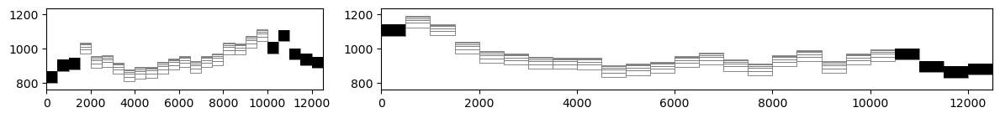

In [15]:
icol = icol + 6;  irow = irow -7
print(nrow, ncol, '__', icol, irow )
def beta_plot(ax):
    pmv=flopy.plot.PlotCrossSection(model=gwf,ax=ax1, line={"row"   : irow}) ; pmv.plot_grid(linewidth=0.5) ; pmv.plot_inactive()
    pmv=flopy.plot.PlotCrossSection(model=gwf,ax=ax2, line={"column": icol}) ; pmv.plot_grid(linewidth=0.5) ; pmv.plot_inactive()
plt.figure(figsize=(12,4))
ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=1, rowspan=1)  ; ax2 = plt.subplot2grid((3, 3), (0, 1), colspan=2, rowspan=1)  ; beta_plot(ax1) ; beta_plot(ax2) 

In [16]:
sim.write_simulation()

writing simulation...
  writing simulation name file...
  writing simulation tdis package...
  writing solution package ims_-1...
  writing model model...
    writing model name file...
    writing package dis...
    writing package ic...
    writing package npf...
    writing package rcha_0...
    writing package river...
    writing package gwd...
    writing package oc...


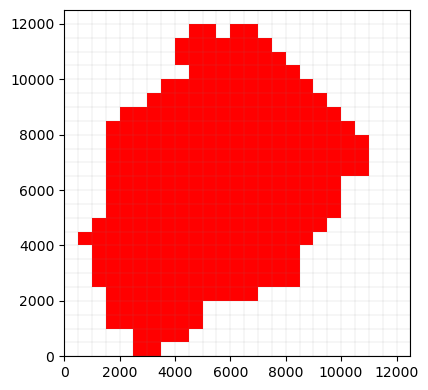

In [17]:
fig = plt.figure(figsize=(13, 4))                             
ax = fig.add_subplot(111, aspect="equal")  ; pmv = flopy.plot.PlotMapView(gwf, ax=ax)  ; lc = pmv.plot_grid(lw=0.1)  
pmv.plot_bc("DRN", plotAll=True, color='red') ;
plt.show()